In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from optimizer_functions import *

from IPython.display import clear_output

### a) ii) ###

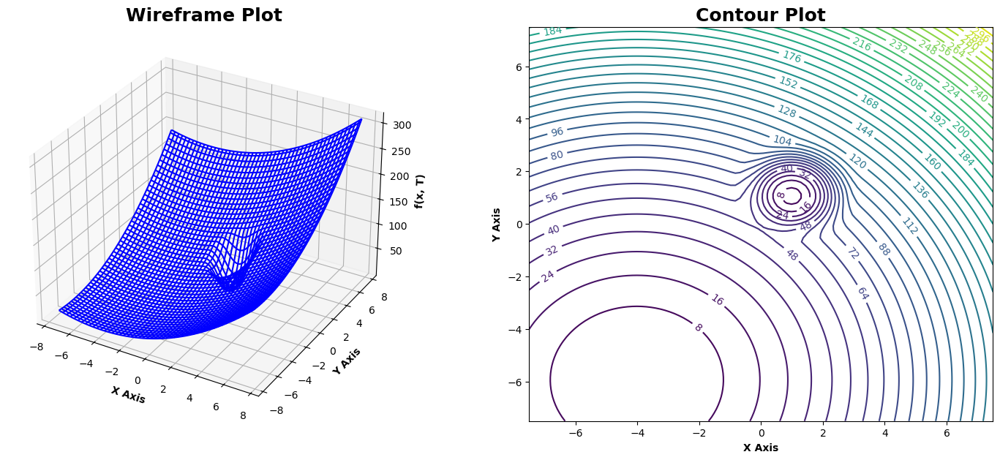

In [3]:
training_data = generate_trainingdata()
x = np.linspace(-7.5, 7.5, 100)
y = np.linspace(-7.5, 7.5, 100)
z = []
for i in x:
    for j in y:
        z.append(f([i,j], training_data))
        
z = np.array(z).reshape(100, 100)
x, y = np.meshgrid(x, y)

fig = plt.figure(figsize=(18, 7))

ax1 = fig.add_subplot(121, projection='3d')
ax1.plot_wireframe(x, y, z, color='blue')
ax1.set_title('Wireframe Plot', fontsize=18, fontweight='bold')
ax1.set_xlabel('X Axis', fontweight='bold')
ax1.set_ylabel('Y Axis', fontweight='bold')
ax1.set_zlabel('f(x, T)', fontweight='bold')


ax2 = fig.add_subplot(122)
contour = ax2.contour(x, y, z, 50)
plt.clabel(contour, inline=1, fontsize=10)
ax2.set_title('Contour Plot', fontsize=18, fontweight='bold')
ax2.set_xlabel('X Axis', fontweight='bold')
ax2.set_ylabel('Y Axis', fontweight='bold')

plt.show()

### b) i) ###

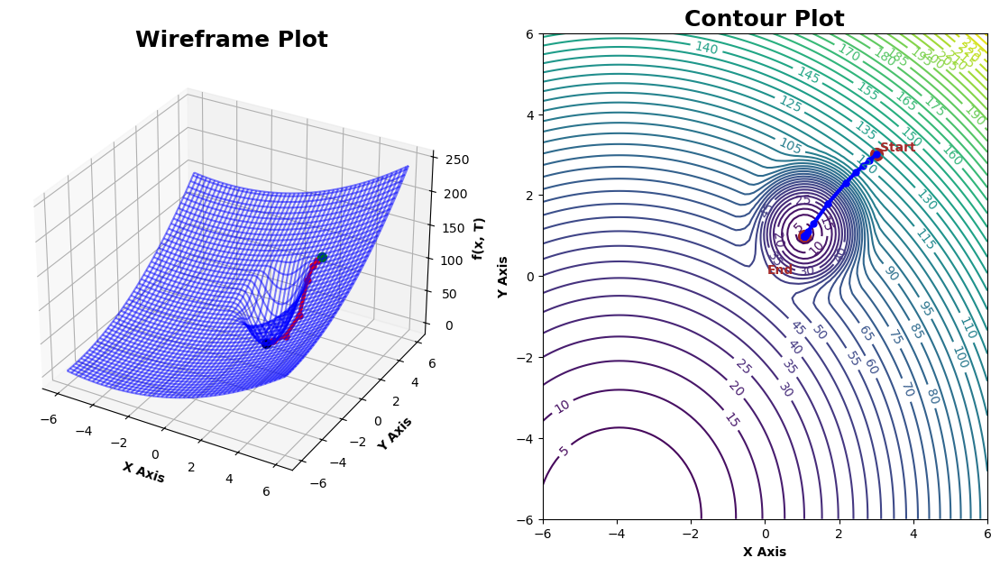

In [6]:
path, f_vals = SGD('constant', f, starting_point=[3,3], data=training_data, alpha=0.01, max_iters=100, tol=-0.1, batch_size=len(training_data))
path_x, path_y = zip(*path)
path_z = f_vals

training_data = generate_trainingdata()
x = np.linspace(-6, 6, 100)
y = np.linspace(-6, 6, 100)
z = []
for i in x:
    for j in y:
        z.append(f([i,j], training_data))
        
z = np.array(z).reshape(100, 100)
x, y = np.meshgrid(x, y)

fig = plt.figure(figsize=(14, 7))

ax1 = fig.add_subplot(121, projection='3d')
ax1.plot_wireframe(x, y, z, color='blue', alpha=0.5)  
ax1.scatter(path_x[0], path_y[0], path_z[0], color='green', s=50)  
ax1.plot(path_x[0:-1], path_y[0:-1], path_z, color='red', linewidth=3, marker='o', markersize=5)  
ax1.scatter(path_x[-1], path_y[-1], path_z[-1], color='black', s=50) 
ax1.set_title('Wireframe Plot', fontsize=18, fontweight='bold')
ax1.set_xlabel('X Axis', fontweight='bold')
ax1.set_ylabel('Y Axis', fontweight='bold')
ax1.set_zlabel('f(x, T)', fontweight='bold')


ax2 = fig.add_subplot(122)
contour = ax2.contour(x, y, z, 50, cmap='viridis')
ax2.plot(path_x, path_y, color='blue', linewidth=3, marker='o', markersize=5)  
ax2.scatter(path_x[0], path_y[0], color='brown', s=100)  
ax2.scatter(path_x[-1], path_y[-1], color='brown', s=100)  
ax2.annotate('Start', xy=(path_x[0], path_y[0]), xytext=(3, 3),
             textcoords='offset points', color='brown', weight='bold')
ax2.annotate('End', xy=(path_x[-1], path_y[-1]), xytext=(-30, -30),
             textcoords='offset points', color='brown', weight='bold')
plt.clabel(contour, inline=1, fontsize=10)
ax2.set_title('Contour Plot', fontsize=18, fontweight='bold')
ax2.set_xlabel('X Axis', fontweight='bold')
ax2.set_ylabel('Y Axis', fontweight='bold')

plt.show()


### b) ii) ###

Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser


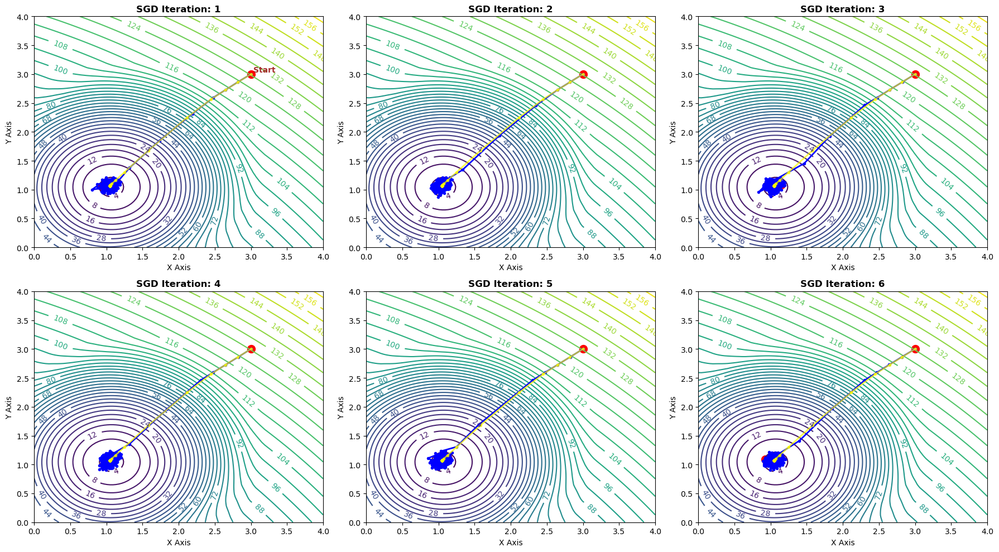

Iteration: 1 finished at [0.9299, 1.0518]
Iteration: 2 finished at [1.0305, 1.0210]
Iteration: 3 finished at [1.1449, 1.0848]
Iteration: 4 finished at [1.0466, 1.0282]
Iteration: 5 finished at [1.1238, 1.1287]
Iteration: 6 finished at [0.9261, 1.0875]


In [7]:
x = np.linspace(0, 4, 100)
y = np.linspace(0, 4, 100)
z = []
for i in x:
    for j in y:
        z.append(f([i,j], training_data))
        
z = np.array(z).reshape(100, 100)
x, y = np.meshgrid(x, y)

final_points = {i:[0.0,0.0] for i in range(1,7)}

fig, axes = plt.subplots(2, 3, figsize=(18, 10))

starting_point = [3, 3]
alpha = 0.01
batch_size = 5
max_iters = 100

for i in range(2):
    for j in range(3):
        ax = axes[i, j]
        path, f_vals = SGD('constant', f, starting_point=[3,3], data=training_data, alpha=alpha, max_iters=max_iters, tol=1e-4, batch_size=batch_size)
        true_path, true_f_vals = SGD('constant', f, starting_point=[3,3], data=training_data, alpha=0.01, max_iters=100, tol=-0.1, batch_size=len(training_data))
        

        path_x, path_y = zip(*path)
        true_path_x, true_path_y = zip(*true_path)

        final_points[3 * i + j + 1][0] += path_x[-1]
        final_points[3 * i + j + 1][1] += path_y[-1]
        

        contour = ax.contour(x, y, z, 50, cmap='viridis')
        ax.plot(path_x, path_y, color='blue', linewidth=2, marker='o', markersize=3, alpha=1)
        ax.plot(true_path_x, true_path_y, color='yellow', linewidth=2, marker='o', markersize=3, alpha=0.7)
        
        ax.scatter(path_x[0], path_y[0], color='red', s=100)  
        if i == 0 and j == 0:
            ax.annotate('Start', xy=(path_x[0], path_y[0]), xytext=(3, 3),
                 textcoords='offset points', color='brown', weight='bold')
            
        
        
        ax.scatter(path_x[-1], path_y[-1], color='red', s=100)  
        ax.clabel(contour, inline=1, fontsize=10)
        ax.set_title(f'SGD Iteration: {3 * i + j + 1}', fontweight='bold')
        ax.set_xlabel('X Axis')
        ax.set_ylabel('Y Axis')

plt.tight_layout()
plt.show()

for k, v in final_points.items():
    print(f"Iteration: {k} finished at [{v[0]:0.4f}, {v[1]:0.4f}]")

### b) iii) ###

Stochastic-Gradient-Descent using Constant Optimiser


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser


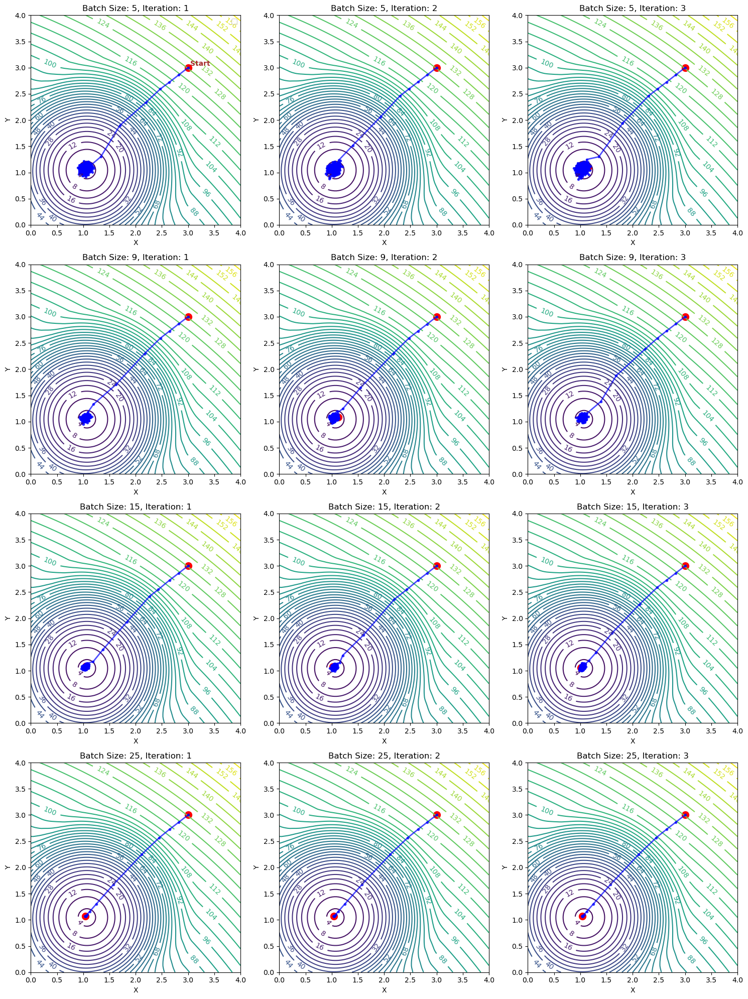

batch_size: 5 finished at [1.0935, 1.0704]
batch_size: 9 finished at [1.0508, 1.0752]
batch_size: 15 finished at [1.0285, 1.0720]
batch_size: 25 finished at [1.0450, 1.0698]


In [8]:
starting_point = [3, 3]
alpha = 0.01
batch_sizes = np.logspace(0.75, np.log10(len(training_data)), num=4, base=10).astype(int)

fig, axes = plt.subplots(4, 3, figsize=(15, 20))

final_points = {i.astype(int):[0.0, 0.0] for i in batch_sizes}

for i in range(4):
    for j in range(3):
        ax = axes[i, j]
        batch_size = batch_sizes[i]  

        path, f_vals = SGD('constant', f, starting_point, data=training_data,
                           alpha=alpha, max_iters=100, tol=1e-6, batch_size=batch_size)


        path_x, path_y = zip(*path)
        path_z = f_vals 
        final_points[batch_size][0] += path_x[-1]/3
        final_points[batch_size][1] += path_y[-1]/3


        contour = ax.contour(x, y, z, 50, cmap='viridis')
        ax.plot(path_x, path_y, color='blue', linewidth=2, marker='o', markersize=3, alpha=0.7)
        ax.scatter(path_x[0], path_y[0], color='red', s=100)  
        if i == 0 and j == 0:
            ax.annotate('Start', xy=(path_x[0], path_y[0]), xytext=(3, 3),
                 textcoords='offset points', color='brown', weight='bold')
        
        ax.scatter(path_x[-1], path_y[-1], color='red', s=100)  
        ax.clabel(contour, inline=1, fontsize=10)
        ax.set_title(f'Batch Size: {batch_size}, Iteration: {j+1}')
        ax.set_xlabel('X')
        ax.set_ylabel('Y')


        if i == 0 and j == 0:
            ax.legend()


plt.tight_layout()
plt.show()

for k, v in final_points.items():
    print(f"batch_size: {k} finished at [{v[0]:0.4f}, {v[1]:0.4f}]")

Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Opt

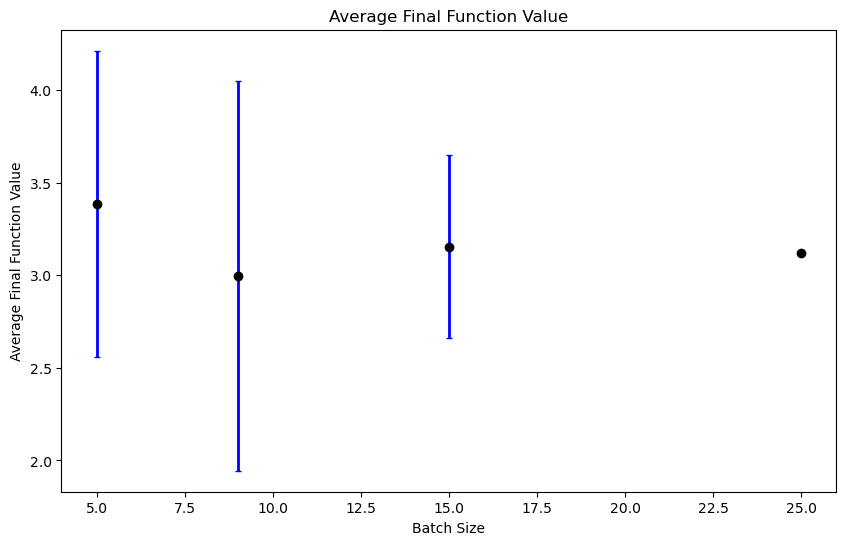

In [9]:
starting_point = [3, 3]
alpha = 0.01
iterations = 5
batch_sizes = np.logspace(0.75, np.log10(len(training_data)), num=4, base=10).astype(int)

final_f_vals = {batch_size: [] for batch_size in batch_sizes}

for batch_size in batch_sizes:
    for _ in range(iterations):
        path, f_vals = SGD('constant', f, starting_point, data=training_data,
                           alpha=alpha, max_iters=100, tol=1e-6, batch_size=batch_size)
        final_f_vals[batch_size].append(f_vals[-1]) 
avg_f_vals = {batch_size: np.mean(vals) for batch_size, vals in final_f_vals.items()}
std_f_vals = {batch_size: np.std(vals) for batch_size, vals in final_f_vals.items()}

fig, ax = plt.subplots(figsize=(10, 6))

batch_sizes_list = list(batch_sizes)
avg_vals_list = [avg_f_vals[bs] for bs in batch_sizes_list]
std_vals_list = [std_f_vals[bs] for bs in batch_sizes_list]

ax.errorbar(batch_sizes_list, avg_vals_list, yerr=std_vals_list, fmt='o', color='black', ecolor='blue', elinewidth=2, capsize=2)

ax.set_title('Average Final Function Value')
ax.set_xlabel('Batch Size')
ax.set_ylabel('Average Final Function Value')

plt.show()

Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser


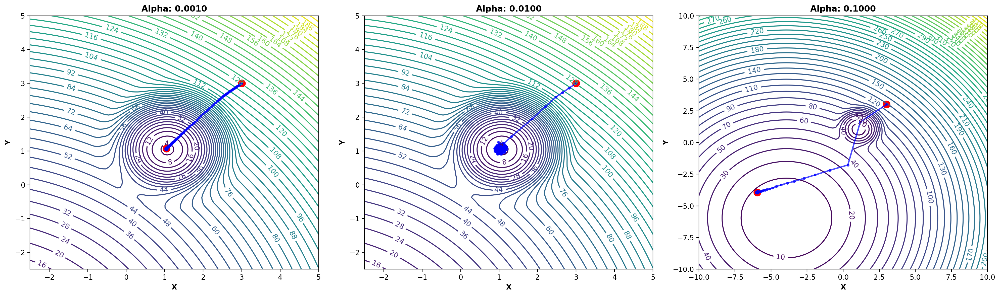

Alpha: 0.001, finished at [1.0448, 1.0693]
Alpha: 0.01, finished at [0.9894, 1.0253]
Alpha: 0.1, finished at [-5.9613, -3.9276]


In [10]:
starting_point = [3, 3]
alphas = np.logspace(-3, -1, num=3, base=10)
batch_size = 5
max_iters = 200

fig, axes = plt.subplots(1, 3, figsize=(20, 6), dpi=200)

final_points = {alpha: [0.0, 0.0] for alpha in alphas}

for i, alpha in enumerate(alphas):
    if alpha < 0.05:
        x_range = np.linspace(-2.5, 5, 100)
        y_range = np.linspace(-2.5, 5, 100)
    else:
        x_range = np.linspace(-10, 10, 100)
        y_range = np.linspace(-10, 10, 100)
    
    z = [f([i, j], training_data) for i in x_range for j in y_range]
    z = np.array(z).reshape(100, 100)
    x, y = np.meshgrid(x_range, y_range)
    
    ax = axes[i]
    path, f_vals = SGD('constant', f, starting_point, data=training_data,
                        alpha=alpha, max_iters=max_iters, tol=1e-6, batch_size=batch_size)
    path_x, path_y = zip(*path)
    final_points[alpha][0] += path_x[-1] 
    final_points[alpha][1] += path_y[-1]

    contour = ax.contour(x, y, z, 50, cmap='viridis')
    ax.plot(path_x, path_y, color='blue', linewidth=2, marker='o', markersize=3, alpha=0.7)
    ax.scatter(path_x[0], path_y[0], color='red', s=100)
    if i == 0 and j == 0:
        ax.annotate('Start', xy=(path_x[0], path_y[0]), xytext=(3, 3),
                    textcoords='offset points', color='brown', weight='bold')
    
    ax.scatter(path_x[-1], path_y[-1], color='red', s=100)
    ax.clabel(contour, inline=1, fontsize=10)
    ax.set_title(f'Alpha: {alpha:.4f}', fontweight='bold')
    ax.set_xlabel('X', fontweight='bold')
    ax.set_ylabel('Y', fontweight='bold')

plt.tight_layout()
plt.show()

for k, v in final_points.items():
    print(f"Alpha: {k}, finished at [{v[0]:0.4f}, {v[1]:0.4f}]")

Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser
Stochastic-Gradient-Descent using Constant Optimiser


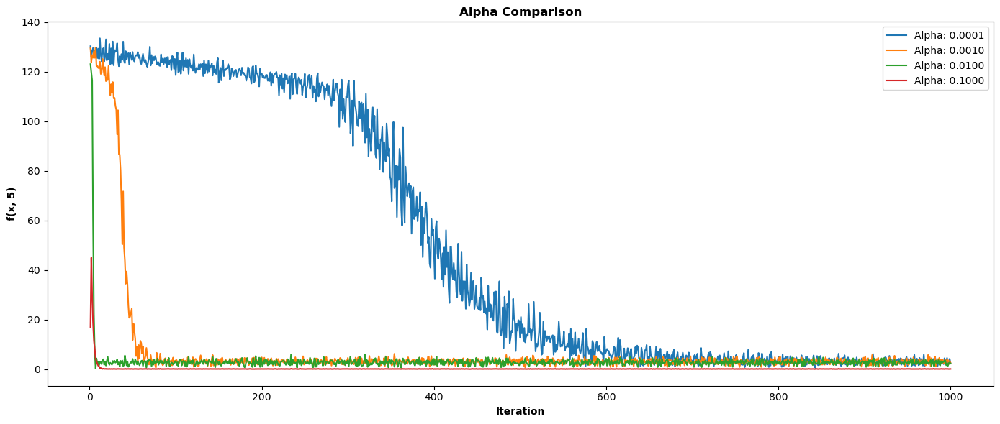

In [11]:
starting_point = [3, 3]
alphas = np.logspace(-4, -1, num=4, base=10)
batch_sizes = np.logspace(0.75, np.log10(len(training_data)), num=4, base=10).astype(int)
max_iters = 200

fig, axs = plt.subplots(1, 1, figsize=(14, 6))

for alpha in alphas:
    _, f_vals = SGD('constant', f, starting_point, data=training_data,
                    alpha=alpha, max_iters=max_iters, tol=1e-6, batch_size=5)
    iterations = list(range(1, len(f_vals) + 1))
    axs.plot(iterations, f_vals, label=f'Alpha: {alpha:.4f}')

axs.set_title('Alpha Comparison', fontweight='bold')
axs.set_xlabel('Iteration', fontweight='bold')
axs.set_ylabel('f(x, 5)', fontweight='bold')
axs.legend()


plt.tight_layout()
plt.show()

### c) i) ###

Stochastic-Gradient-Descent using Polyak Optimiser
Stochastic-Gradient-Descent using Polyak Optimiser
Stochastic-Gradient-Descent using Polyak Optimiser
Stochastic-Gradient-Descent using Polyak Optimiser


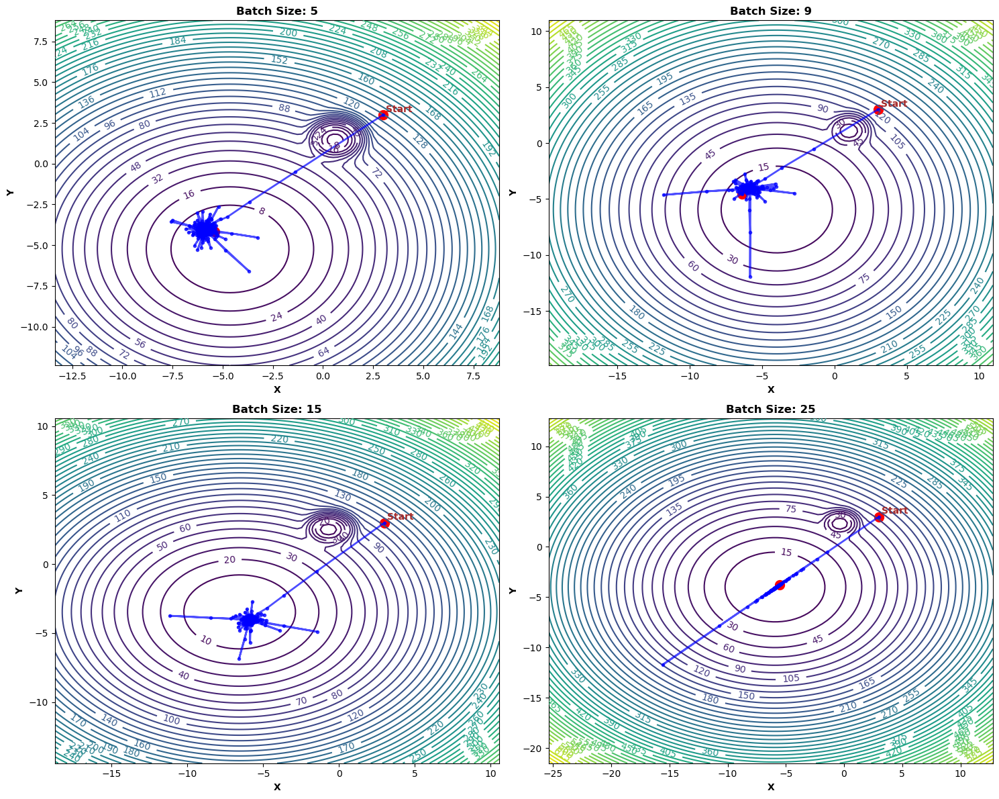

Batch size: 5, finished at [-5.4056, -4.1686]
Batch size: 9, finished at [-6.4028, -4.5676]
Batch size: 15, finished at [-5.8186, -4.0241]
Batch size: 25, finished at [-5.5521, -3.7733]


In [12]:
training_data = generate_trainingdata()

starting_point = [3, 3]
alpha = 0.01
batch_sizes = np.logspace(0.75, np.log10(len(training_data)), num=4, base=10).astype(int)
max_iters = 100

fig, axes = plt.subplots(2, 2, figsize=(15, 12))
axes = axes.flatten()  

final_points = {batch: [0.0, 0.0] for batch in batch_sizes}

for i, batch_size in enumerate(batch_sizes):
    ax = axes[i]
    path, f_vals = SGD('polyak', f=f, starting_point=starting_point, data=training_data, epsilon=1e-6, max_iters=max_iters, batch_size=batch_size)
    path_x, path_y = zip(*path)
    final_points[batch_size][0] += path_x[-1]
    final_points[batch_size][1] += path_y[-1]

    size = max((max(path_x) - min(path_x)), (max(path_y) - min(path_y))) + 1

    x = np.linspace(min(path_x) - size / 2, max(path_x) + size / 2, 100)
    y = np.linspace(min(path_y) - size / 2, max(path_y) + size / 2, 100)
    z = [f([a, b], training_data) for a in x for b in y]
    z = np.array(z).reshape(100, 100)
    x, y = np.meshgrid(x, y)

    contour = ax.contour(x, y, z, 50, cmap='viridis')
    ax.plot(path_x, path_y, color='blue', linewidth=2, marker='o', markersize=3, alpha=0.7)
    ax.scatter(path_x[0], path_y[0], color='red', s=100)
    
    ax.annotate('Start', xy=(path_x[0], path_y[0]), xytext=(3, 3),
                textcoords='offset points', color='brown', weight='bold')
    
    ax.scatter(path_x[-1], path_y[-1], color='red', s=100)
    ax.clabel(contour, inline=1, fontsize=10)
    ax.set_title(f'Batch Size: {batch_size}', fontweight='bold')
    ax.set_xlabel('X', fontweight='bold')
    ax.set_ylabel('Y', fontweight='bold')

plt.tight_layout()
plt.show()

for k, v in final_points.items():
    print(f"Batch size: {k}, finished at [{v[0]:0.4f}, {v[1]:0.4f}]")

Stochastic-Gradient-Descent using Polyak Optimiser
Stochastic-Gradient-Descent using Polyak Optimiser
Stochastic-Gradient-Descent using Polyak Optimiser
Stochastic-Gradient-Descent using Polyak Optimiser


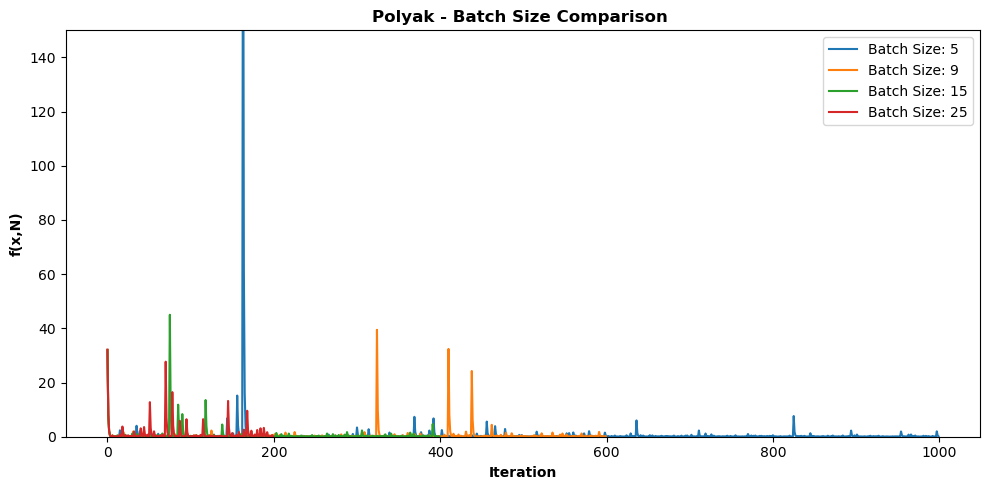

In [13]:
starting_point = [3, 3]
alphas = np.logspace(-4, -1, num=4, base=10)
batch_sizes = np.logspace(0.75, np.log10(len(training_data)), num=4, base=10).astype(int)
max_iters = 200

fig, axes = plt.subplots(1, 1, figsize=(10, 5)) 


for batch_size in batch_sizes:
    _, f_vals = SGD('polyak', f=f, starting_point=starting_point, data=training_data, epsilon=1e-6, max_iters=max_iters, batch_size=batch_size)
    iterations = list(range(len(f_vals)))
    plt.plot(iterations, f_vals, label=f'Batch Size: {batch_size}')

plt.title('Polyak - Batch Size Comparison ' , fontweight='bold')
plt.xlabel('Iteration', fontweight='bold')
plt.ylim(0, 150)
plt.ylabel('f(x,N)', fontweight='bold')
plt.legend()

plt.tight_layout()
plt.show()

Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser


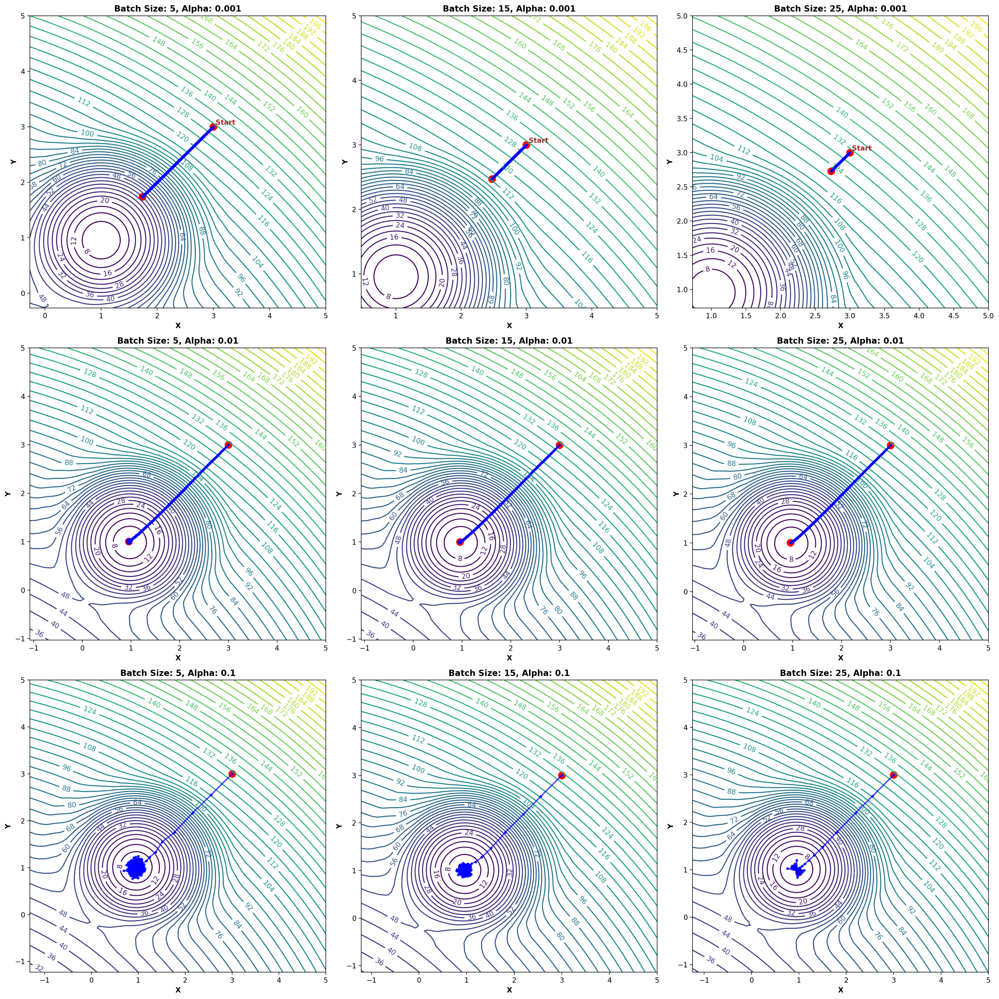

Batch size: 5, finished at [3.6455, 3.7460]
Batch size: 15, finished at [4.4221, 4.5248]
Batch size: 25, finished at [4.6878, 4.6882]


In [14]:
training_data = generate_trainingdata()

starting_point = [3, 3]
alphas = np.logspace(-3, -1, num=3, base=10)
beta = 0.95

batch_sizes = np.linspace(5,25, 3 ).astype(int)
max_iters = 250

fig, axes = plt.subplots(3, 3, figsize=(20, 20), dpi=200) 

final_points = {batch: [0.0, 0.0] for batch in batch_sizes}

for j, batch_size in enumerate(batch_sizes):
    for i, alpha0 in enumerate(alphas):
        ax = axes[i, j]
        path, f_vals = SGD('rmsprop',f=f, starting_point=starting_point, data=training_data, alpha0=alpha0, beta=beta, epsilon=1e-6,  max_iters=max_iters, batch_size=batch_size)
        path_x, path_y = zip(*path)
        final_points[batch_size][0] += path_x[-1]
        final_points[batch_size][1] += path_y[-1]

        size = max((max(path_x) - min(path_x)), (max(path_y) - min(path_y))) + 2

        x = np.linspace(min(path_x)-2, max(path_x)+2, 100)
        y = np.linspace(min(path_y)-2, max(path_y)+2, 100)
        z = [f([a, b], training_data) for a in x for b in y]
        z = np.array(z).reshape(100, 100)
        x, y = np.meshgrid(x, y)

        contour = ax.contour(x, y, z, 50, cmap='viridis')
        ax.plot(path_x, path_y, color='blue', linewidth=2, marker='o', markersize=3, alpha=0.7)
        ax.scatter(path_x[0], path_y[0], color='red', s=100)
        
        if i == 0: 
            ax.annotate('Start', xy=(path_x[0], path_y[0]), xytext=(3, 3),
                        textcoords='offset points', color='brown', weight='bold')
        
        ax.scatter(path_x[-1], path_y[-1], color='red', s=100)
        ax.clabel(contour, inline=1, fontsize=10)
        ax.set_title(f'Batch Size: {batch_size}, Alpha: {alpha0}', fontweight='bold')
        ax.set_xlabel('X', fontweight='bold')
        ax.set_ylabel('Y', fontweight='bold')

plt.tight_layout()
plt.show()

for k, v in final_points.items():
    print(f"Batch size: {k}, finished at [{v[0]:0.4f}, {v[1]:0.4f}]")

Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser
Stochastic-Gradient-Descent using RMSProp Optimiser


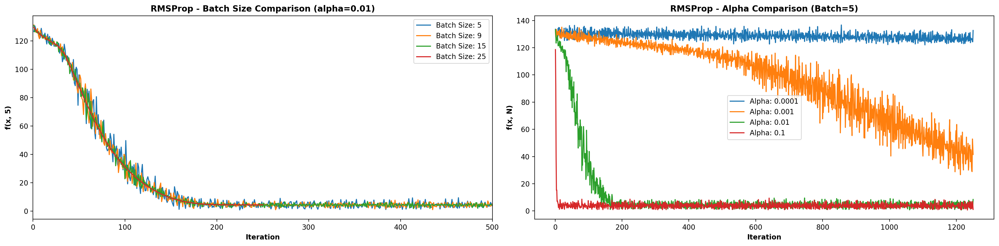

In [15]:
starting_point = [3, 3]
alphas = np.logspace(-4,-1, num=4, base=10)
beta = 0.95
batch_sizes = np.logspace(0.75, np.log10(len(training_data)), num=4, base=10).astype(int)
max_iters = 250


fig, axs = plt.subplots(1, 2, figsize=(20, 5), dpi=200)


for batch_size in batch_sizes:
    _, f_vals = SGD('rmsprop',f=f, starting_point=starting_point, data=training_data, alpha0=0.01, beta=beta, epsilon=1e-6,  max_iters=max_iters, batch_size=batch_size)
    iterations = list(range(1, len(f_vals) + 1))
    axs[0].plot(iterations, f_vals, label=f'Batch Size: {batch_size}')

axs[0].set_title('RMSProp - Batch Size Comparison (alpha=0.01)', fontweight='bold')
axs[0].set_xlabel('Iteration', fontweight='bold')
axs[0].set_xlim(0, 500)
axs[0].set_ylabel('f(x, 5)', fontweight='bold')
axs[0].legend()


for alpha in alphas:
    _, f_vals = SGD('rmsprop',f=f, starting_point=starting_point, data=training_data, alpha0=alpha, beta=beta, epsilon=1e-6,  max_iters=max_iters, batch_size=5)
    iterations = list(range(1, len(f_vals) + 1))
    axs[1].plot(iterations, f_vals, label=f'Alpha: {alpha}')

axs[1].set_title('RMSProp - Alpha Comparison (Batch=5)', fontweight='bold')
axs[1].set_xlabel('Iteration', fontweight='bold')
axs[1].set_ylabel('f(x, N)', fontweight='bold')
axs[1].legend()

plt.tight_layout()
plt.show()

Stochastic-Gradient-Descent using Heavy-Ball Optimiser
Stochastic-Gradient-Descent using Heavy-Ball Optimiser
Stochastic-Gradient-Descent using Heavy-Ball Optimiser
Stochastic-Gradient-Descent using Heavy-Ball Optimiser
Stochastic-Gradient-Descent using Heavy-Ball Optimiser
Stochastic-Gradient-Descent using Heavy-Ball Optimiser
Stochastic-Gradient-Descent using Heavy-Ball Optimiser
Stochastic-Gradient-Descent using Heavy-Ball Optimiser
Stochastic-Gradient-Descent using Heavy-Ball Optimiser


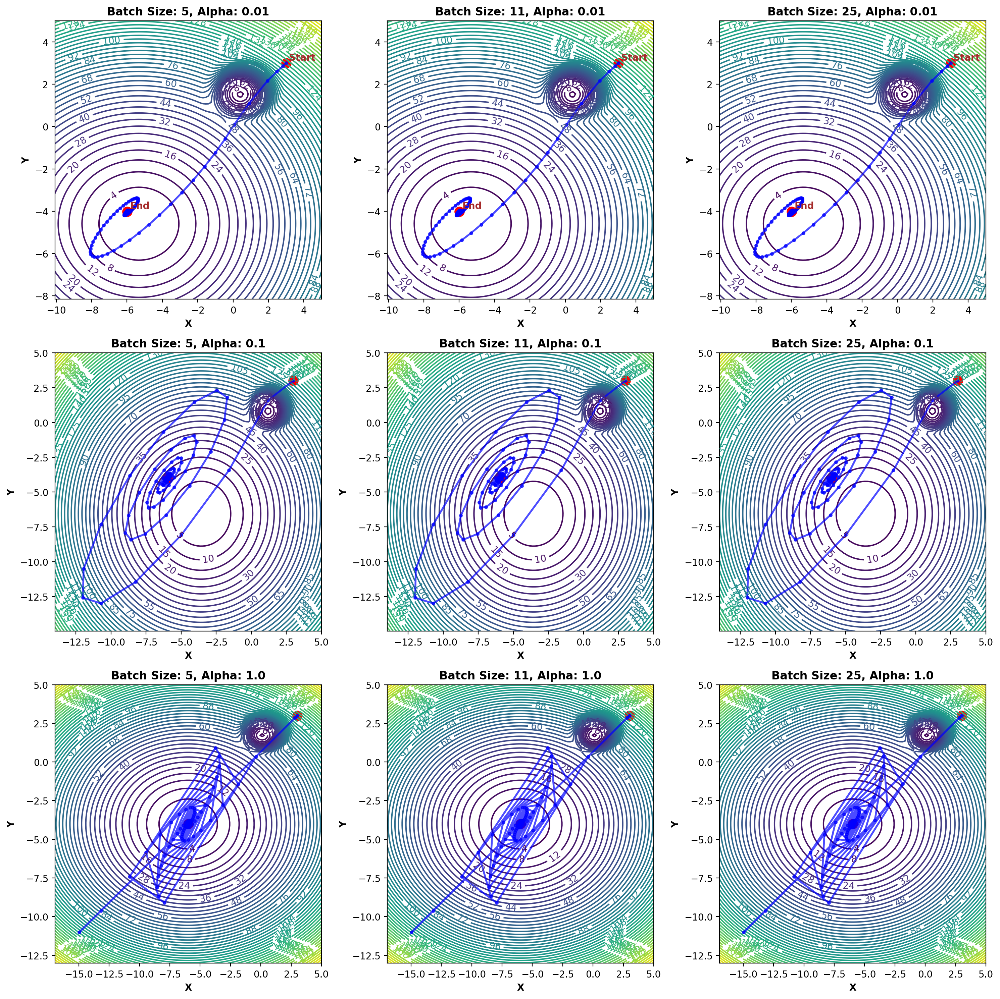

Batch size: 5, Alpha: 0.01	 finished at [-5.9874, -4.0095]
Batch size: 5, Alpha: 0.1	 finished at [-5.9874, -4.0095]
Batch size: 5, Alpha: 1.0	 finished at [-5.9874, -4.0095]
Batch size: 11, Alpha: 0.01	 finished at [-5.9874, -4.0095]
Batch size: 11, Alpha: 0.1	 finished at [-5.9874, -4.0095]
Batch size: 11, Alpha: 1.0	 finished at [-5.9874, -4.0095]
Batch size: 25, Alpha: 0.01	 finished at [-5.9874, -4.0095]
Batch size: 25, Alpha: 0.1	 finished at [-5.9874, -4.0095]
Batch size: 25, Alpha: 1.0	 finished at [-5.9874, -4.0095]


In [16]:
training_data = generate_trainingdata()

starting_point = [3, 3]
alphas = np.logspace(-2, 0, num=3, base=10)
beta = 0.9

batch_sizes = np.logspace(0.75, np.log10(len(training_data)), num=3, base=10).astype(int)
max_iters = 250

fig, axes = plt.subplots(3, 3, figsize=(15, 15), dpi=200) 

final_points = {batch: {
    alpha: [0.0, 0.0] for alpha in alphas
} for batch in batch_sizes}

for j, batch_size in enumerate(batch_sizes):
    for i, alpha in enumerate(alphas):
        ax = axes[i, j]
        path, f_vals = SGD('hb',f=f, starting_point=starting_point, data=training_data, alpha=alpha, beta=beta, epsilon=1e-6,  max_iters=max_iters, tol=-0.1, batch_size=batch_size)
        path_x, path_y = zip(*path)
        final_points[batch_size][alpha][0] = path_x[-1]
        final_points[batch_size][alpha][1] = path_y[-1]

        size = max((max(path_x) - min(path_x)), (max(path_y) - min(path_y))) + 2

        x = np.linspace(min(path_x)-2, max(path_x)+2, 100)
        y = np.linspace(min(path_y)-2, max(path_y)+2, 100)
        z = [f([a, b], training_data) for a in x for b in y]
        z = np.array(z).reshape(100, 100)
        x, y = np.meshgrid(x, y)

        contour = ax.contour(x, y, z, 50, cmap='viridis')
        ax.plot(path_x, path_y, color='blue', linewidth=2, marker='o', markersize=3, alpha=0.7)
        ax.scatter(path_x[0], path_y[0], color='red', s=100)
        
        if i == 0:
            ax.annotate('Start', xy=(path_x[0], path_y[0]), xytext=(3, 3),
                        textcoords='offset points', color='brown', weight='bold')
            ax.annotate('End', xy=(path_x[-1], path_y[-1]), xytext=(3, 3),
                        textcoords='offset points', color='brown', weight='bold')
        
        ax.scatter(path_x[-1], path_y[-1], color='red', s=100)
        ax.clabel(contour, inline=1, fontsize=10)
        ax.set_title(f'Batch Size: {batch_size}, Alpha: {alpha}', fontweight='bold')
        ax.set_xlabel('X', fontweight='bold')
        ax.set_ylabel('Y', fontweight='bold')

plt.tight_layout()
plt.show()

for k, a in final_points.items():
    for x, v in a.items():
        print(f"Batch size: {k}, Alpha: {x}\t finished at [{v[0]:0.4f}, {v[1]:0.4f}]")

Stochastic-Gradient-Descent using Heavy-Ball Optimiser
Stochastic-Gradient-Descent using Heavy-Ball Optimiser
Stochastic-Gradient-Descent using Heavy-Ball Optimiser
Stochastic-Gradient-Descent using Heavy-Ball Optimiser
Stochastic-Gradient-Descent using Heavy-Ball Optimiser
Stochastic-Gradient-Descent using Heavy-Ball Optimiser


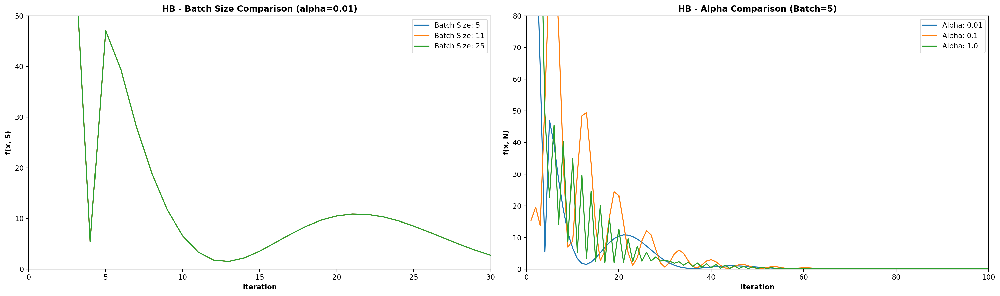

In [20]:
starting_point = [3, 3]
alphas = np.logspace(-2, 0, num=3, base=10)
beta = 0.9
batch_sizes = np.logspace(0.75, np.log10(len(training_data)), num=3, base=10).astype(int)
max_iters = 250

fig, axs = plt.subplots(1, 2, figsize=(20, 6), dpi=200)

for batch_size in batch_sizes:
    _, f_vals = SGD('hb',f=f, starting_point=starting_point, data=training_data, alpha=0.01, beta=beta, epsilon=1e-6,  max_iters=max_iters, tol=-0.1, batch_size=batch_size)
    iterations = list(range(1, len(f_vals) + 1))
    axs[0].plot(iterations, f_vals, label=f'Batch Size: {batch_size}' )

axs[0].set_title('HB - Batch Size Comparison (alpha=0.01)', fontweight='bold')
axs[0].set_xlabel('Iteration', fontweight='bold')
axs[0].set_xlim(0,30)
axs[0].set_ylim(0,50)
axs[0].set_ylabel('f(x, 5)', fontweight='bold')
axs[0].legend()

for alpha in alphas:
    _, f_vals = SGD('hb',f=f, starting_point=starting_point, data=training_data, alpha=alpha, beta=beta, epsilon=1e-6,  max_iters=max_iters, tol=-0.1, batch_size=5)
    iterations = list(range(1, len(f_vals) + 1))
    axs[1].plot(iterations, f_vals, label=f'Alpha: {alpha}')

axs[1].set_title('HB - Alpha Comparison (Batch=5)', fontweight='bold')
axs[1].set_xlabel('Iteration', fontweight='bold')
axs[1].set_ylabel('f(x, N)', fontweight='bold')
axs[1].set_xlim(0,100)
axs[1].set_ylim(0,0)
axs[1].legend()

plt.tight_layout()
plt.show()

Stochastic-Gradient-Descent using Adam Optimiser
Stochastic-Gradient-Descent using Adam Optimiser
Stochastic-Gradient-Descent using Adam Optimiser
Stochastic-Gradient-Descent using Adam Optimiser
Stochastic-Gradient-Descent using Adam Optimiser
Stochastic-Gradient-Descent using Adam Optimiser
Stochastic-Gradient-Descent using Adam Optimiser
Stochastic-Gradient-Descent using Adam Optimiser
Stochastic-Gradient-Descent using Adam Optimiser


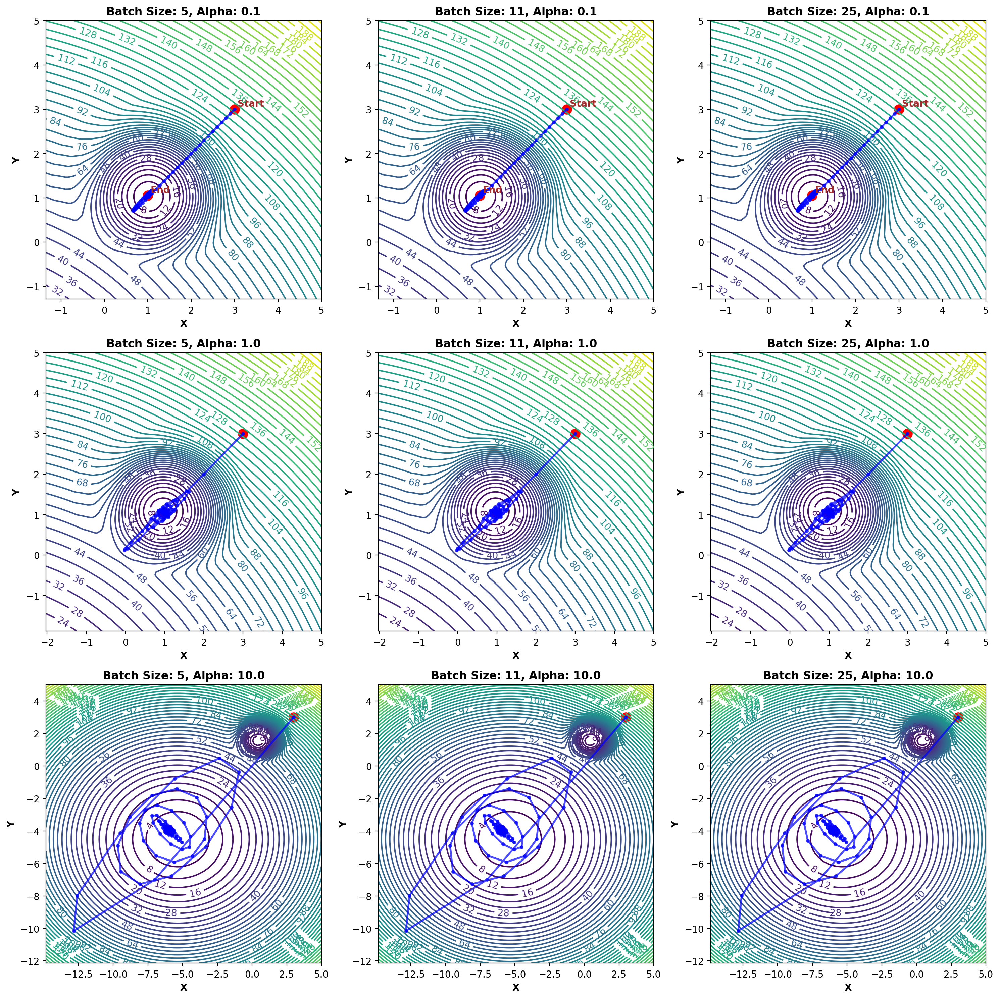

Batch size: 5, Alpha: 0.1	 finished at [0.9970, 1.0498]
Batch size: 5, Alpha: 1.0	 finished at [0.9970, 1.0498]
Batch size: 5, Alpha: 10.0	 finished at [-6.0030, -3.9502]
Batch size: 11, Alpha: 0.1	 finished at [0.9970, 1.0498]
Batch size: 11, Alpha: 1.0	 finished at [0.9970, 1.0498]
Batch size: 11, Alpha: 10.0	 finished at [-6.0030, -3.9502]
Batch size: 25, Alpha: 0.1	 finished at [0.9970, 1.0498]
Batch size: 25, Alpha: 1.0	 finished at [0.9970, 1.0498]
Batch size: 25, Alpha: 10.0	 finished at [-6.0030, -3.9502]


In [18]:
training_data = generate_trainingdata()

starting_point = [3, 3]
alphas = np.logspace(-1, 1, num=3, base=10)
beta1 = 0.9
beta2 = 0.999

batch_sizes = np.logspace(0.75, np.log10(len(training_data)), num=3, base=10).astype(int)
max_iters = 250

fig, axes = plt.subplots(3, 3, figsize=(15, 15), dpi=200) 

final_points = {batch: {
    alpha: [0.0, 0.0] for alpha in alphas
} for batch in batch_sizes}

for j, batch_size in enumerate(batch_sizes):
    for i, alpha in enumerate(alphas):
        ax = axes[i, j]
        path, f_vals = SGD('adam',f=f, starting_point=starting_point, data=training_data, alpha=alpha, beta1=beta1, beta2=beta2, epsilon=1e-6,  max_iters=max_iters, tol=-0.1, batch_size=batch_size)
        path_x, path_y = zip(*path)
        final_points[batch_size][alpha][0] = path_x[-1]
        final_points[batch_size][alpha][1] = path_y[-1]

        size = max((max(path_x) - min(path_x)), (max(path_y) - min(path_y))) + 2

        x = np.linspace(min(path_x)-2, max(path_x)+2, 100)
        y = np.linspace(min(path_y)-2, max(path_y)+2, 100)
        z = [f([a, b], training_data) for a in x for b in y]
        z = np.array(z).reshape(100, 100)
        x, y = np.meshgrid(x, y)

        contour = ax.contour(x, y, z, 50, cmap='viridis')
        ax.plot(path_x, path_y, color='blue', linewidth=2, marker='o', markersize=3, alpha=0.7)
        ax.scatter(path_x[0], path_y[0], color='red', s=100)
        
        if i == 0: 
            ax.annotate('Start', xy=(path_x[0], path_y[0]), xytext=(3, 3),
                        textcoords='offset points', color='brown', weight='bold')
            ax.annotate('End', xy=(path_x[-1], path_y[-1]), xytext=(3, 3),
                        textcoords='offset points', color='brown', weight='bold')
        
        ax.scatter(path_x[-1], path_y[-1], color='red', s=100)
        ax.clabel(contour, inline=1, fontsize=10)
        ax.set_title(f'Batch Size: {batch_size}, Alpha: {alpha}', fontweight='bold')
        ax.set_xlabel('X', fontweight='bold')
        ax.set_ylabel('Y', fontweight='bold')

plt.tight_layout()
plt.show()

for k, a in final_points.items():
    for x, v in a.items():
        print(f"Batch size: {k}, Alpha: {x}\t finished at [{v[0]:0.4f}, {v[1]:0.4f}]")

Stochastic-Gradient-Descent using Adam Optimiser
Stochastic-Gradient-Descent using Adam Optimiser
Stochastic-Gradient-Descent using Adam Optimiser
Stochastic-Gradient-Descent using Adam Optimiser
Stochastic-Gradient-Descent using Adam Optimiser
Stochastic-Gradient-Descent using Adam Optimiser


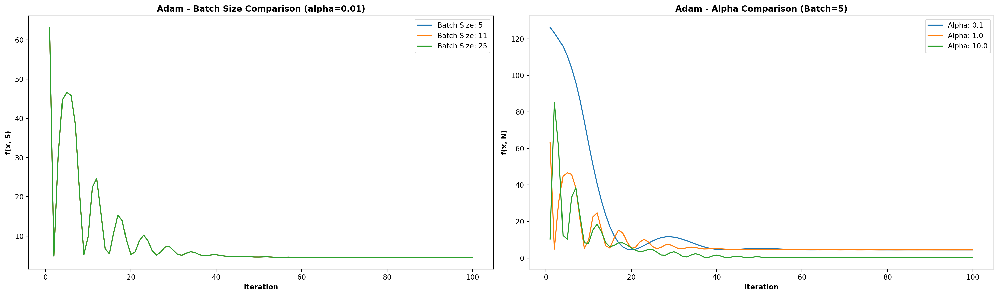

In [19]:
starting_point = [3, 3]
alphas = np.logspace(-1, 1, num=3, base=10)
beta1 = 0.9
beta2 = 0.999
batch_sizes = np.logspace(0.75, np.log10(len(training_data)), num=3, base=10).astype(int)
max_iters = 100


fig, axs = plt.subplots(1, 2, figsize=(20, 6), dpi=200)


for batch_size in batch_sizes:
    _, f_vals = SGD('adam',f=f, starting_point=starting_point, data=training_data, alpha=1, beta1=beta1, beta2=beta2, epsilon=1e-6,  max_iters=max_iters, tol=-0.1, batch_size=batch_size)
    iterations = list(range(1, len(f_vals) + 1))
    axs[0].plot(iterations, f_vals, label=f'Batch Size: {batch_size}', )

axs[0].set_title('Adam - Batch Size Comparison (alpha=0.01)', fontweight='bold')
axs[0].set_xlabel('Iteration', fontweight='bold')
axs[0].set_ylabel('f(x, 5)', fontweight='bold')
axs[0].legend()


for alpha in alphas:
    _, f_vals = SGD('adam',f=f, starting_point=starting_point, data=training_data, alpha=alpha, beta1=beta1, beta2=beta2, epsilon=1e-6,  max_iters=max_iters, tol=-0.1, batch_size=5)
    iterations = list(range(1, len(f_vals) + 1))
    axs[1].plot(iterations, f_vals, label=f'Alpha: {alpha}')

axs[1].set_title('Adam - Alpha Comparison (Batch=5)', fontweight='bold')
axs[1].set_xlabel('Iteration', fontweight='bold')
axs[1].set_ylabel('f(x, N)', fontweight='bold')
axs[1].legend()

plt.tight_layout()
plt.show()